# CAT Testing notebook

## Environment setting

In [1]:
import os 
os.environ["CUDA_VISIBLE_DEVICES"] = "3"
import torch
from diffusers import AutoPipelineForText2Image, DiffusionPipeline
base_model = "runwayml/stable-diffusion-v1-5"
seed = 42
lora_path = "/data7/OnomaAi101/CAT/results/vanila_lora/cat_statue_20240222/checkpoint-600"
dreambooth_path = "/data7/OnomaAi101/CAT/results/dreambooth/cat_statue_20240222"
cat_path = "/data7/OnomaAi101/CAT/results/cat/cat_statue_20240222/checkpoint-600"
prompt = "a cat statue on a green field"
generator = torch.Generator(device="cuda").manual_seed(seed)

/home/onomaai/anaconda3/envs/CAT/lib/python3.10/site-packages/tqdm/auto.py:21: TqdmWarning: IProgress not found. Please update jupyter and ipywidgets. See https://ipywidgets.readthedocs.io/en/stable/user_install.html
  from .autonotebook import tqdm as notebook_tqdm


In [11]:
pipeline = AutoPipelineForText2Image.from_pretrained(base_model).to("cuda")
prompt = "a thin bird"

for seed in range(0, 100):
    generator = torch.Generator(device="cuda").manual_seed(seed)
    image = pipeline(prompt, generator=generator).images[0]
    image.save(f"/data7/OnomaAi101/CAT/data/textual_inversion/thin_bird_regulation/{seed}.png")

Loading pipeline components...:  86%|████████▌ | 6/7 [00:00<00:00,  6.51it/s]

100%|██████████| 50/50 [00:06<00:00,  7.68it/s]


## Vanila Lora

In [6]:
pipeline = AutoPipelineForText2Image.from_pretrained(base_model, torch_dtype=torch.float16).to("cuda")
pipeline.load_lora_weights(lora_path, weight_name="pytorch_lora_weights.safetensors")
seed = 42
generator = torch.Generator(device="cuda").manual_seed(seed)
prompt = f"<shs>, a cat statue on a bed_seed_{seed}"
image = pipeline(prompt, generator = generator).images[0]
image.save(f"{lora_path}/{prompt}.png")

Loading pipeline components...: 100%|██████████| 7/7 [00:01<00:00,  3.80it/s]
You have saved the LoRA weights using the old format. To convert the old LoRA weights to the new format, you can first load them in a dictionary and then create a new dictionary like the following: `new_state_dict = {f'unet.{module_name}': params for module_name, params in old_state_dict.items()}`.
100%|██████████| 50/50 [00:02<00:00, 17.06it/s]


## Dreambooth

In [7]:
pipeline = DiffusionPipeline.from_pretrained(dreambooth_path, use_auth_token=True).to("cuda")
prompt = "<shs>, a cat statue on a green field"
seed = 42
generator = torch.Generator(device="cuda").manual_seed(seed)
image = pipeline(prompt, generator = generator).images[0]
image.save(f"/data7/OnomaAi101/CAT/results/dreambooth/cat_statue_20240222/{prompt}_seed_{seed}.png")

The config attributes {'image_encoder': [None, None]} were passed to StableDiffusionPipeline, but are not expected and will be ignored. Please verify your model_index.json configuration file.
Keyword arguments {'image_encoder': [None, None]} are not expected by StableDiffusionPipeline and will be ignored.
Loading pipeline components...:  71%|███████▏  | 5/7 [00:03<00:01,  1.37it/s]Some weights of StableDiffusionSafetyChecker were not initialized from the model checkpoint at /data7/OnomaAi101/CAT/results/dreambooth/cat_statue_20240222/safety_checker and are newly initialized: ['vision_model.vision_model.embeddings.position_ids']
You should probably TRAIN this model on a down-stream task to be able to use it for predictions and inference.
Loading pipeline components...:  86%|████████▌ | 6/7 [00:05<00:00,  1.05it/s]/home/onomaai/anaconda3/envs/CAT/lib/python3.10/site-packages/transformers/models/clip/feature_extraction_clip.py:28: FutureWarning: The class CLIPFeatureExtractor is deprecate

# CAT

In [8]:
pipeline = AutoPipelineForText2Image.from_pretrained(base_model, torch_dtype=torch.float16).to("cuda")
pipeline.load_lora_weights(cat_path, weight_name="pytorch_lora_weights.safetensors")
seed = 42
generator = torch.Generator(device="cuda").manual_seed(seed)
prompt = f"<shs>, a cat statue on a bed_seed_{seed}"
image = pipeline(prompt, generator = generator).images[0]
image.save(f"{lora_path}/{prompt}.png")

Loading pipeline components...: 100%|██████████| 7/7 [00:01<00:00,  4.18it/s]
You have saved the LoRA weights using the old format. To convert the old LoRA weights to the new format, you can first load them in a dictionary and then create a new dictionary like the following: `new_state_dict = {f'unet.{module_name}': params for module_name, params in old_state_dict.items()}`.
100%|██████████| 50/50 [00:02<00:00, 18.55it/s]


## Metric test

In [9]:
from utils.eval_utils import image_similarity, prompt_similarity

image1 = "/data7/OnomaAi101/CAT/data/textual_inversion/cat_statue/image3.jpeg"
image2 = "/data7/OnomaAi101/CAT/results/vanila_lora/cat_statue_20240222/checkpoint-600/identity_score/<shs>, a cat statue standing at a desk, looking straight ahead.png"
image_similarity(image1, image2)

"""
prompt = "a cat statue lying on the carpet"
image = "/home/paneah/CAT/data/textual_inversion/cat_statue/image1.jpeg"

prompt_similarity(prompt, image)
"""

'\nprompt = "a cat statue lying on the carpet"\nimage = "/home/paneah/CAT/data/textual_inversion/cat_statue/image1.jpeg"\n\nprompt_similarity(prompt, image)\n'

In [10]:
import jsonlines
import os
f = jsonlines.open("/data7/OnomaAi101/CAT/data/textual_inversion/cat_statue/metadata.jsonl")
lora_pipeline = AutoPipelineForText2Image.from_pretrained(base_model, torch_dtype=torch.float16).to("cuda")
lora_pipeline.load_lora_weights(lora_path, weight_name="pytorch_lora_weights.safetensors")
cat_pipeline = AutoPipelineForText2Image.from_pretrained(base_model, torch_dtype=torch.float16).to("cuda")
cat_pipeline.load_lora_weights(cat_path, weight_name="pytorch_lora_weights.safetensors")
dreambooth_pipeline = DiffusionPipeline.from_pretrained(dreambooth_path, use_auth_token=True).to("cuda")

for path in [lora_path, cat_path, dreambooth_path]:
    os.makedirs(f"{path}/identity_score", exist_ok=True)

seed = 42
generator = torch.Generator(device="cuda").manual_seed(seed)

for line in f.iter():
    prompt = line["text"]
    lora_image = lora_pipeline(prompt, generator = generator).images[0]
    lora_image.save(f"{lora_path}/identity_score/{prompt}.png")
    cat_pipeline_image = cat_pipeline(prompt, generator = generator).images[0]
    cat_pipeline_image.save(f"{cat_path}/identity_score/{prompt}.png")
    dreambooth_path_image = dreambooth_pipeline(prompt, generator = generator).images[0]
    dreambooth_path_image.save(f"{dreambooth_path}/identity_score/{prompt}.png")

Loading pipeline components...: 100%|██████████| 7/7 [00:01<00:00,  4.41it/s]
You have saved the LoRA weights using the old format. To convert the old LoRA weights to the new format, you can first load them in a dictionary and then create a new dictionary like the following: `new_state_dict = {f'unet.{module_name}': params for module_name, params in old_state_dict.items()}`.
Loading pipeline components...: 100%|██████████| 7/7 [00:01<00:00,  4.48it/s]
You have saved the LoRA weights using the old format. To convert the old LoRA weights to the new format, you can first load them in a dictionary and then create a new dictionary like the following: `new_state_dict = {f'unet.{module_name}': params for module_name, params in old_state_dict.items()}`.
The config attributes {'image_encoder': [None, None]} were passed to StableDiffusionPipeline, but are not expected and will be ignored. Please verify your model_index.json configuration file.
Keyword arguments {'image_encoder': [None, None]} ar

In [11]:
import jsonlines
import os
f = jsonlines.open("/data7/OnomaAi101/CAT/data/textual_inversion/cat_statue/metadata.jsonl")
lora_pipeline = AutoPipelineForText2Image.from_pretrained(base_model, torch_dtype=torch.float16).to("cuda")
lora_pipeline.load_lora_weights(lora_path, weight_name="pytorch_lora_weights.safetensors")
cat_pipeline = AutoPipelineForText2Image.from_pretrained(base_model, torch_dtype=torch.float16).to("cuda")
cat_pipeline.load_lora_weights(cat_path, weight_name="pytorch_lora_weights.safetensors")
dreambooth_pipeline = DiffusionPipeline.from_pretrained(dreambooth_path, use_auth_token=True).to("cuda")

for path in [lora_path, cat_path, dreambooth_path]:
    os.makedirs(f"{path}/prompt_score", exist_ok=True)
    
seed = 42
generator = torch.Generator(device="cuda").manual_seed(seed)

for line in f.iter():
    prompt = line["text"].replace("<shs>, ", "")
    lora_image = lora_pipeline(prompt, generator = generator).images[0]
    lora_image.save(f"{lora_path}/prompt_score/{prompt}.png")
    cat_pipeline_image = cat_pipeline(prompt, generator = generator).images[0]
    cat_pipeline_image.save(f"{cat_path}/prompt_score/{prompt}.png")
    dreambooth_path_image = dreambooth_pipeline(prompt, generator = generator).images[0]
    dreambooth_path_image.save(f"{dreambooth_path}/prompt_score/{prompt}.png")

Loading pipeline components...: 100%|██████████| 7/7 [00:01<00:00,  3.71it/s]
You have saved the LoRA weights using the old format. To convert the old LoRA weights to the new format, you can first load them in a dictionary and then create a new dictionary like the following: `new_state_dict = {f'unet.{module_name}': params for module_name, params in old_state_dict.items()}`.
Loading pipeline components...: 100%|██████████| 7/7 [00:01<00:00,  4.02it/s]
You have saved the LoRA weights using the old format. To convert the old LoRA weights to the new format, you can first load them in a dictionary and then create a new dictionary like the following: `new_state_dict = {f'unet.{module_name}': params for module_name, params in old_state_dict.items()}`.
The config attributes {'image_encoder': [None, None]} were passed to StableDiffusionPipeline, but are not expected and will be ignored. Please verify your model_index.json configuration file.
Keyword arguments {'image_encoder': [None, None]} ar

In [12]:
import os
lora_pipeline = AutoPipelineForText2Image.from_pretrained(base_model, torch_dtype=torch.float16).to("cuda")
lora_pipeline.load_lora_weights(lora_path, weight_name="pytorch_lora_weights.safetensors")
cat_pipeline = AutoPipelineForText2Image.from_pretrained(base_model, torch_dtype=torch.float16).to("cuda")
cat_pipeline.load_lora_weights(cat_path, weight_name="pytorch_lora_weights.safetensors")
dreambooth_pipeline = DiffusionPipeline.from_pretrained(dreambooth_path, use_auth_token=True).to("cuda")
base_pipeline = AutoPipelineForText2Image.from_pretrained(base_model, torch_dtype=torch.float16).to("cuda")

for path in [lora_path, cat_path, dreambooth_path, "/data7/OnomaAi101/CAT/data/textual_inversion/cat_statue"]:
    os.makedirs(f"{path}/knowledge_preservation", exist_ok=True)

seed = 42
generator = torch.Generator(device="cuda").manual_seed(seed)

prompts = ["a cat statue on a green field", "a cat statue with emerald eyes and a bronze-colored coat", "a cat statue perched on a windowsill overlooking the city", "a cat statue wearing a tiny collar with a bell around its neck", "a cat statue depicted in a playful pose, with one paw raised", "a cat statue sitting gracefully on a pedestal in the museum", "a cat statue adorned with intricate patterns and symbols", "a cat statue positioned at the entrance of the park, welcoming visitors", "a cat statue standing proudly on a pedestal, symbolizing grace and elegance", "a cat statue nestled among flowers in the botanical garden"]

for prompt in prompts:
    lora_image = lora_pipeline(prompt, generator = generator).images[0]
    lora_image.save(f"{lora_path}/knowledge_preservation/{prompt}.png")
    cat_pipeline_image = cat_pipeline(prompt, generator = generator).images[0]
    cat_pipeline_image.save(f"{cat_path}/knowledge_preservation/{prompt}.png")
    dreambooth_path_image = dreambooth_pipeline(prompt, generator = generator).images[0]
    dreambooth_path_image.save(f"{dreambooth_path}/knowledge_preservation/{prompt}.png")
    base_pipeline_image = base_pipeline(prompt, generator = generator).images[0]
    base_pipeline_image.save(f"/data7/OnomaAi101/CAT/data/textual_inversion/cat_statue/knowledge_preservation/{prompt}.png")
    

Loading pipeline components...: 100%|██████████| 7/7 [00:02<00:00,  3.37it/s]
You have saved the LoRA weights using the old format. To convert the old LoRA weights to the new format, you can first load them in a dictionary and then create a new dictionary like the following: `new_state_dict = {f'unet.{module_name}': params for module_name, params in old_state_dict.items()}`.
Loading pipeline components...: 100%|██████████| 7/7 [00:01<00:00,  4.16it/s]
You have saved the LoRA weights using the old format. To convert the old LoRA weights to the new format, you can first load them in a dictionary and then create a new dictionary like the following: `new_state_dict = {f'unet.{module_name}': params for module_name, params in old_state_dict.items()}`.
The config attributes {'image_encoder': [None, None]} were passed to StableDiffusionPipeline, but are not expected and will be ignored. Please verify your model_index.json configuration file.
Keyword arguments {'image_encoder': [None, None]} ar

In [13]:
#knowledge preservation score
import jsonlines
import os

f = jsonlines.open("/data7/OnomaAi101/CAT/data/textual_inversion/cat_statue/metadata.jsonl")

prompts = []

for line in f.iter():
    prompts.append(line["text"])
    
def path_maker(path, prompts, score):
    paths = []
    if score == "prompt_score":
        for prompt in prompts:
            prompt = prompt.replace("<shs>, ", "")
            paths.append(f"{path}/{score}/{prompt}.png")
    else:
        for prompt in prompts:
            paths.append(f"{path}/{score}/{prompt}.png")
    return paths
    
# 1. Load the images
lora_images_token = path_maker(lora_path, prompts, "identity_score")
lora_images_no_token = path_maker(lora_path, prompts, "prompt_score")
cat_images_token = path_maker(cat_path, prompts, "identity_score")
cat_images_no_token = path_maker(cat_path, prompts, "prompt_score")
dreambooth_images_token = path_maker(dreambooth_path, prompts, "identity_score")
dreambooth_images_no_token = path_maker(dreambooth_path, prompts, "prompt_score")

lora_knowledge_preservation_scores = 0
cat_knowledge_preservation_scores = 0
dreambooth_knowledge_preservation_scores = 0

for num_img in range(len(lora_images_token)):
    lora_image_token = lora_images_token[num_img]
    lora_image_no_token = lora_images_no_token[num_img]
    cat_image_token = cat_images_token[num_img]
    cat_image_no_token = cat_images_no_token[num_img]
    dreambooth_image_token = dreambooth_images_token[num_img]
    dreambooth_image_no_token = dreambooth_images_no_token[num_img]
    lora_knowledge_preservation_scores += image_similarity(lora_image_token, lora_image_no_token)
    cat_knowledge_preservation_scores += image_similarity(cat_image_token, cat_image_no_token)
    dreambooth_knowledge_preservation_scores += image_similarity(dreambooth_image_token, dreambooth_image_no_token)
    
print(f"Dreambooth knowledge preservation score: {dreambooth_knowledge_preservation_scores/len(lora_images_token)}")
print(f"Lora knowledge preservation score: {lora_knowledge_preservation_scores/len(lora_images_token)}")
print(f"Cat knowledge preservation score: {cat_knowledge_preservation_scores/len(lora_images_token)}")

Dreambooth knowledge preservation score: 0.9568006147940954
Lora knowledge preservation score: 0.9382731765508652
Cat knowledge preservation score: 0.8736898948748907


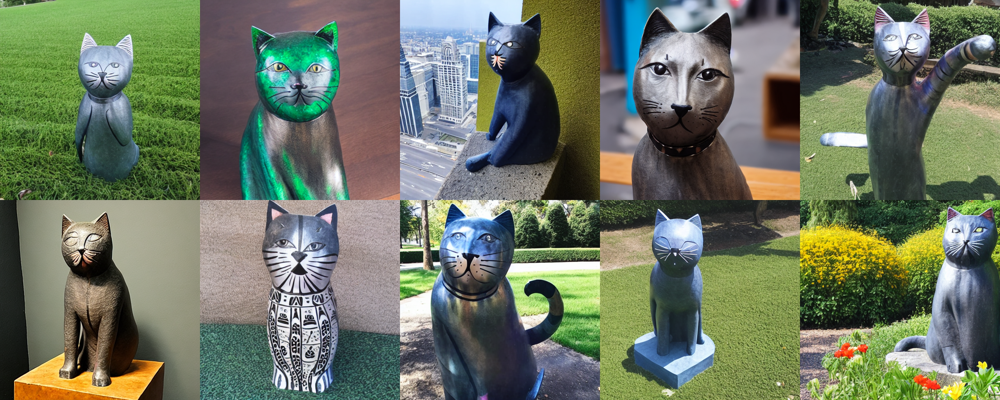

In [14]:
#generate grid within a folder 
import os
import numpy as np
from PIL import Image

prompts = ["a cat statue on a green field", "a cat statue with emerald eyes and a bronze-colored coat", "a cat statue perched on a windowsill overlooking the city", "a cat statue wearing a tiny collar with a bell around its neck", "a cat statue depicted in a playful pose, with one paw raised", "a cat statue sitting gracefully on a pedestal in the museum", "a cat statue adorned with intricate patterns and symbols", "a cat statue positioned at the entrance of the park, welcoming visitors", "a cat statue standing proudly on a pedestal, symbolizing grace and elegance", "a cat statue nestled among flowers in the botanical garden"]

def generate_grid(images, grid_size, save_path):
    images = [Image.open(image) for image in images]
    # RGB to BGR
    images = [image.convert("RGB") for image in images]
    # create empty white images to fill the grid
    required_rows = len(images) // grid_size
    required_rows += 1 if len(images) % grid_size else 0
    grid_height = images[0].height * required_rows
    grid_width = images[0].width * grid_size
    grid = Image.new("RGB", (grid_width, grid_height), (255, 255, 255))
    # fill the grid
    for i, image in enumerate(images):
        row = i // grid_size
        col = i % grid_size
        grid.paste(image, (col * image.width, row * image.height))
    grid.save(save_path)
def generate_grid_no_save(images, grid_size):
    images = [Image.open(image) for image in images]
    # RGB to BGR
    images = [image.convert("RGB") for image in images]
    # create empty white images to fill the grid
    required_rows = len(images) // grid_size
    required_rows += 1 if len(images) % grid_size else 0
    grid_height = images[0].height * required_rows
    grid_width = images[0].width * grid_size
    grid = Image.new("RGB", (grid_width, grid_height), (255, 255, 255))
    # fill the grid
    for i, image in enumerate(images):
        row = i // grid_size
        col = i % grid_size
        grid.paste(image, (col * image.width, row * image.height))
    return grid

lora_images = [f"{lora_path}/knowledge_preservation/{prompt}.png" for prompt in prompts]

generate_grid(lora_images, 5, f"{lora_path}/knowledge_preservation/grid.png")

display(Image.open(f"{lora_path}/knowledge_preservation/grid.png"))

100%|██████████| 4/4 [00:00<00:00, 37617.08it/s]


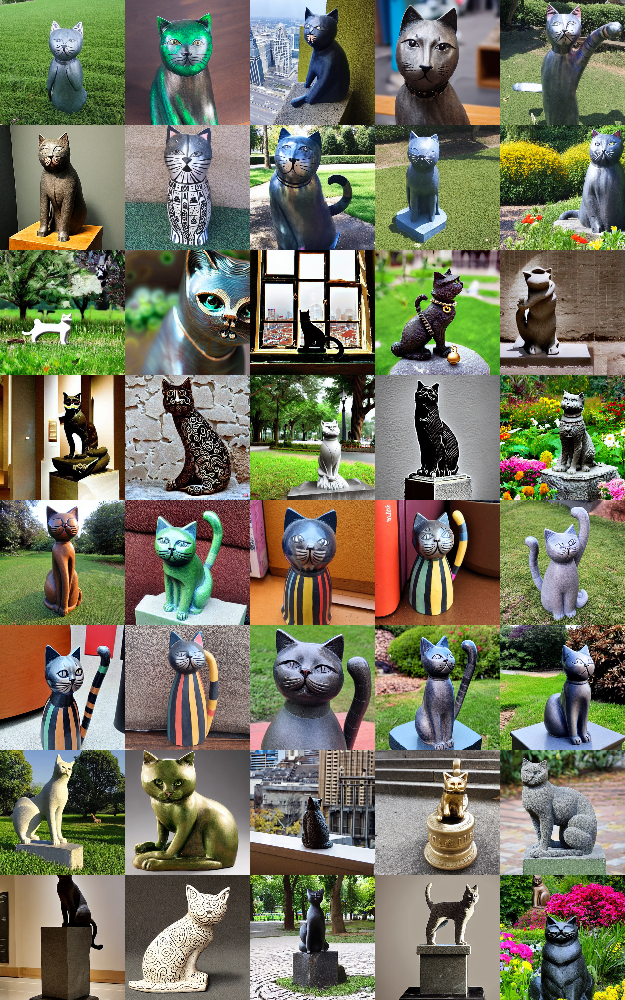

In [15]:
# create large grid to compare the images
from tqdm import tqdm
base_model_results = "/data7/OnomaAi101/CAT/data/textual_inversion/cat_statue/knowledge_preservation"
paths = [lora_path, cat_path, dreambooth_path, base_model_results]
images_container = []
for path in tqdm(paths):
    if path == base_model_results:
        images = [f"{path}/{prompt}.png" for prompt in prompts]
    else:
        images = [f"{path}/knowledge_preservation/{prompt}.png" for prompt in prompts]
    images_container.append(images)

# finally create the large grid
large_grid = generate_grid_no_save(images_container[0] + images_container[1] + images_container[2] + images_container[3], 5)
display(large_grid)

In [16]:
import daam 
from PIL import Image

pipeline = DiffusionPipeline.from_pretrained(base_model, use_auth_token=True).to("cuda")
seed = 42
generator = torch.Generator(device="cuda").manual_seed(seed)

prompt = "a cat statue adorned with intricate patterns and symbols"

with daam.trace(pipeline, save_heads=True) as trace:
    image = pipeline(prompt, generator=generator).images[0]
    statue_map = trace.compute_global_heat_map().compute_word_heat_map('cat statue')

100%|██████████| 50/50 [00:23<00:00,  2.09it/s]


tensor([[0.4252, 0.4816, 0.4662,  ..., 0.4942, 0.5505, 0.5866],
        [0.4145, 0.4858, 0.4403,  ..., 0.4952, 0.5239, 0.5415],
        [0.4489, 0.5053, 0.4626,  ..., 0.5534, 0.5062, 0.5137],
        ...,
        [0.4481, 0.4930, 0.4853,  ..., 0.3759, 0.4004, 0.3495],
        [0.4341, 0.4298, 0.4320,  ..., 0.4425, 0.3820, 0.3565],
        [0.3977, 0.4328, 0.4090,  ..., 0.3825, 0.3935, 0.3665]],
       device='cuda:0')

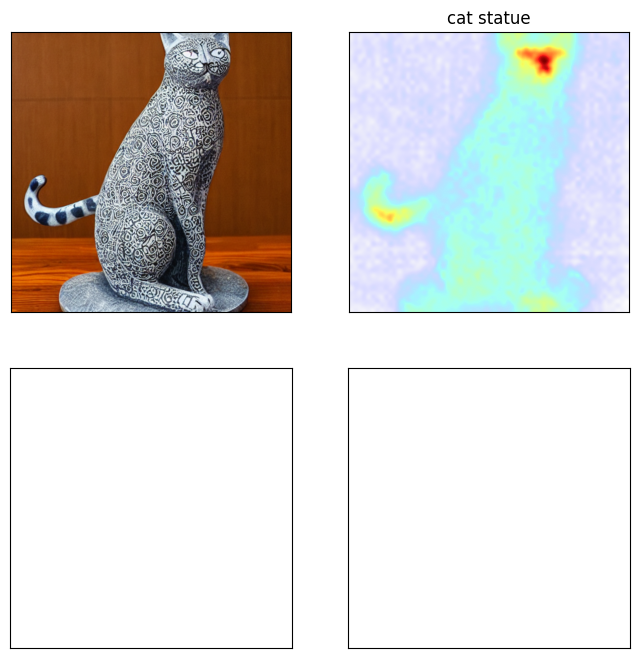

In [17]:
from matplotlib import pyplot as plt

def make_im_subplots(*args):
    fig, ax = plt.subplots(*args)
    for ax_ in ax.flatten():
        ax_.set_xticks([])
        ax_.set_yticks([])
    return fig, ax

plt.rcParams['figure.figsize'] = (8, 8)


fig, ax = make_im_subplots(2, 2)
white = Image.new("RGB", (512, 512), (255, 255, 255))
ax[0,0].imshow(image)
ax[0,1].imshow(white)
statue_map.plot_overlay(white, ax=ax[0,1])
statue_map.heatmap


In [ ]:
from PIL import Image
import torch
import numpy as np
import matplotlib.pyplot as plt
import torch.nn.functional as F

def tensor_to_image(tensor):
    tensor = tensor.squeeze()
    tensor = tensor.detach().cpu().numpy()
    return Image.fromarray(tensor)

def plot_image(tensor):
    image = tensor_to_image(tensor)
    plt.imshow(image, cmap="jet")
    plt.axis("off")
    plt.show()
    
im = statue_map.heatmap.unsqueeze(0).unsqueeze(0)
im = F.interpolate(im.float().detach(), size=(white.size[0], white.size[1]), mode='bicubic')
im = im.cpu().detach().squeeze()
im = tensor_to_image(im)
im.show()

Error: no "view" rule for type "image/png" passed its test case
       (for more information, add "--debug=1" on the command line)
